In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 873.6/873.6 kB 22.3 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import os
from IPython.display import Image, display
from IPython.display import clear_output
clear_output()


In [ ]:
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.6 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="90mxKHVB1G1PceVyukIb")

In [ ]:
project = rf.workspace("sa-dx8nu").project("plate-detect")
version = project.version(1)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.98, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to plate-detect-1 in yolov8:: 100%|██████████| 7722/7722 [00:01<00:00, 7192.33it/s]


In [ ]:
!yolo model=detect task=detect mode=train data=/content/plate-detect-1/data.yaml epochs=20 imgsz=640 model=yolov10b.pt

100% 39.7M/39.7M [00:01<00:00, 27.4MB/s]
Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov10b.pt, data=/content/plate-detect-1/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_cr

Résultats globaux (sur toutes les classes) :
Précision (Box P) : 82.1% — Le modèle identifie correctement les objets avec une bonne précision.
Rappel (R) : 81.7% — Le modèle détecte la majorité des objets dans les images.
mAP50 : 83.3% — Score de précision moyenne à un seuil IoU de 50%, indiquant de bonnes performances globales en détection.
mAP50-95 : 53.5% — Score plus strict mesurant la précision sur plusieurs seuils IoU. C'est un bon résultat pour une première itération d'entraînement.
Par classe :
Licence Plate :
Précision : 70.3%
Rappel : 66.4%
mAP50 : 67.7%
mAP50-95 : 40.2%
Plate (plaque) :
Précision : 94%
Rappel : 97.1%
mAP50 : 98.9%
mAP50-95 : 66.7%
Analyse :
le modèle détecte très bien la classe "plate" (plaque), avec des scores de précision et rappel très élevés.


In [ ]:
from google.colab import files
files.download('runs/detect/train/weights/best.pt')  # ou le nom correct de votre modèle


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!yolo task=detect mode=val model=runs/detect/train/weights/best.pt data=/content/plate-detect-1/data.yaml


Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs
val: Scanning /content/plate-detect-1/valid/labels.cache... 579 images, 0 backgrounds, 0 corrupt: 100% 579/579 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 37/37 [00:19<00:00,  1.86it/s]
                   all        579        594      0.822      0.819      0.833      0.535
               licence         43         50      0.705      0.669      0.677      0.402
                 plate        536        544      0.939       0.97      0.989      0.667
Speed: 0.2ms preprocess, 30.2ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


Résumé des performances
Précision (Box P) : 82.2% — L'exactitude des boîtes prédictives.
Rappel (R) : 81.9% — La proportion d'objets détectés par rapport à ceux qui étaient présents.
mAP50 : 83.3% — Précision moyenne à un seuil IoU de 50%.
mAP50-95 : 53.5% — Précision moyenne sur plusieurs seuils IoU.
Par classe
Licence :

Précision : 70.5%
Rappel : 66.9%
mAP50 : 67.7%
mAP50-95 : 40.2%
Plate :

Précision : 93.9%
Rappel : 97%
mAP50 : 98.9%
mAP50-95 : 66.7%
Analyse des résultats
Les performances globales sont similaires à celles obtenues lors de l'entraînement, avec une légère amélioration dans la précision et le rappel pour toutes les classes.


In [ ]:
from google.colab import files
files.download('/content/runs')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!yolo task=detect mode=predict model=runs/detect/train/weights/best.pt source=/content/plate-detect-1/test/images/CarLongPlate129_jpg.rf.e928edf270fed0fba46d5699d93b9fbd.jpg


Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs

image 1/1 /content/plate-detect-1/test/images/CarLongPlate129_jpg.rf.e928edf270fed0fba46d5699d93b9fbd.jpg: 640x640 1 plate, 45.5ms
Speed: 4.8ms preprocess, 45.5ms inference, 28.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [ ]:
!yolo task=detect mode=predict model=runs/detect/train/weights/best.pt source=/content/carplate.jpeg


Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs

image 1/1 /content/carplate.jpeg: 544x640 1 licence, 87.0ms
Speed: 5.3ms preprocess, 87.0ms inference, 44.4ms postprocess per image at shape (1, 3, 544, 640)
Results saved to runs/detect/predict5
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [ ]:
!yolo task=detect mode=predict model=runs/detect/train/weights/best.pt source=/content/carcanadaplate.jpeg


Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs

image 1/1 /content/carcanadaplate.jpeg: 480x640 1 licence, 48.3ms
Speed: 4.1ms preprocess, 48.3ms inference, 29.1ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict6
💡 Learn more at https://docs.ultralytics.com/modes/predict


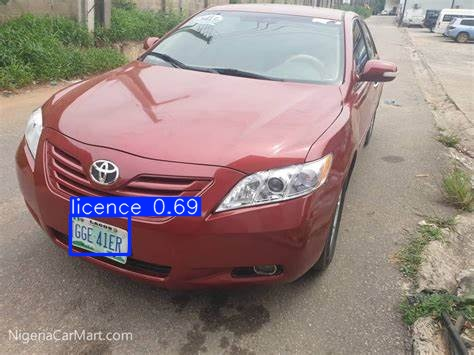

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Remplacez par le chemin correct de votre image annotée
annotated_image_path = '/content/runs/detect/predict6/carcanadaplate.jpeg'  # Ajustez ce chemin
image = cv2.imread(annotated_image_path)

cv2_imshow(image)


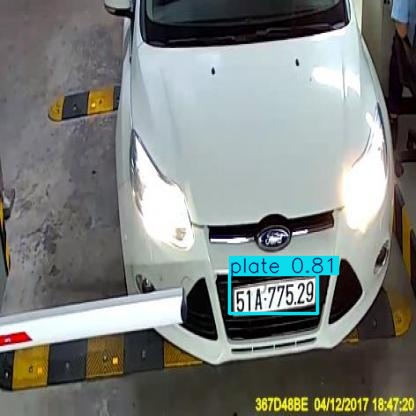

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Remplacez par le chemin correct de votre image annotée
annotated_image_path = '/content/runs/detect/predict/CarLongPlate129_jpg.rf.e928edf270fed0fba46d5699d93b9fbd.jpg'  # Ajustez ce chemin
image = cv2.imread(annotated_image_path)

cv2_imshow(image)


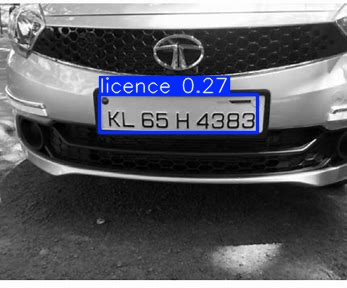

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Remplacez par le chemin correct de votre image annotée
annotated_image_path = '/content/runs/detect/predict5/carplate.jpeg'  # Ajustez ce chemin
image = cv2.imread(annotated_image_path)

cv2_imshow(image)


In [ ]:
!pip install easyocr


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 43.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 51.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 281.3/281.3 kB 22.3 MB/s eta 0:00:00


In [ ]:
import easyocr
import cv2
from google.colab.patches import cv2_imshow


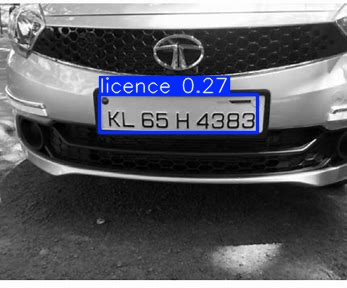

Texte détecté : ['licence 0.27', 'KL 65H4383']


In [ ]:
import easyocr
import cv2
from google.colab.patches import cv2_imshow

# Initialiser EasyOCR
reader = easyocr.Reader(['en'])

def extract_text_from_plate(image_path):
    # Charger l'image annotée
    image = cv2.imread(image_path)

    # Afficher l'image annotée
    cv2_imshow(image)

    # Utiliser EasyOCR pour lire le texte de l'image
    results = reader.readtext(image)

    # Extraire et afficher le texte
    text_results = []
    for result in results:
        text_results.append(result[1])  # result[1] contient le texte détecté

    return text_results

# Remplacez par le chemin de votre image annotée
annotated_image_path = '/content/runs/detect/predict5/carplate.jpeg'  # Ajustez ce chemin
text = extract_text_from_plate(annotated_image_path)

# Afficher les résultats
print("Texte détecté :", text)


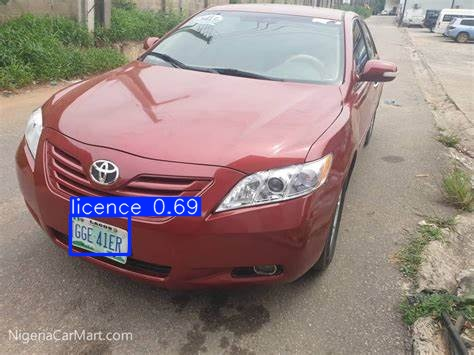

Texte détecté : ['licence 0.69', '@6E QUER', 'NigenaCarMartcom']


In [ ]:
# Remplacez par le chemin de votre image annotée
annotated_image_path = '/content/runs/detect/predict6/carcanadaplate.jpeg'  # Ajustez ce chemin
text = extract_text_from_plate(annotated_image_path)

# Afficher les résultats
print("Texte détecté :", text)

Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs

image 1/1 /content/temp_frame.jpg: 384x640 (no detections), 47.2ms
Speed: 3.0ms preprocess, 47.2ms inference, 10.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict8
💡 Learn more at https://docs.ultralytics.com/modes/predict


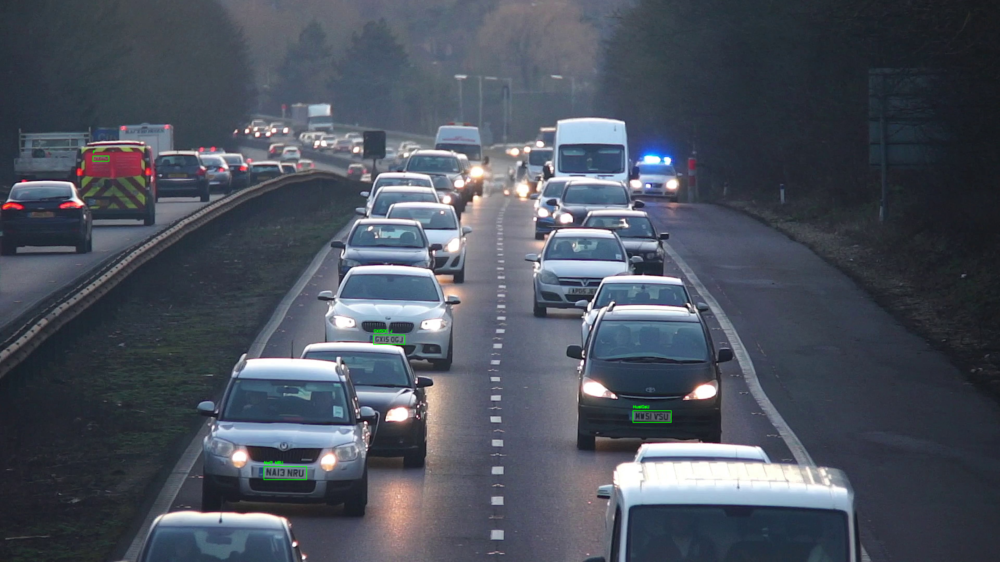

Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs

image 1/1 /content/temp_frame.jpg: 384x640 1 plate, 46.9ms
Speed: 2.9ms preprocess, 46.9ms inference, 30.3ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict9
💡 Learn more at https://docs.ultralytics.com/modes/predict


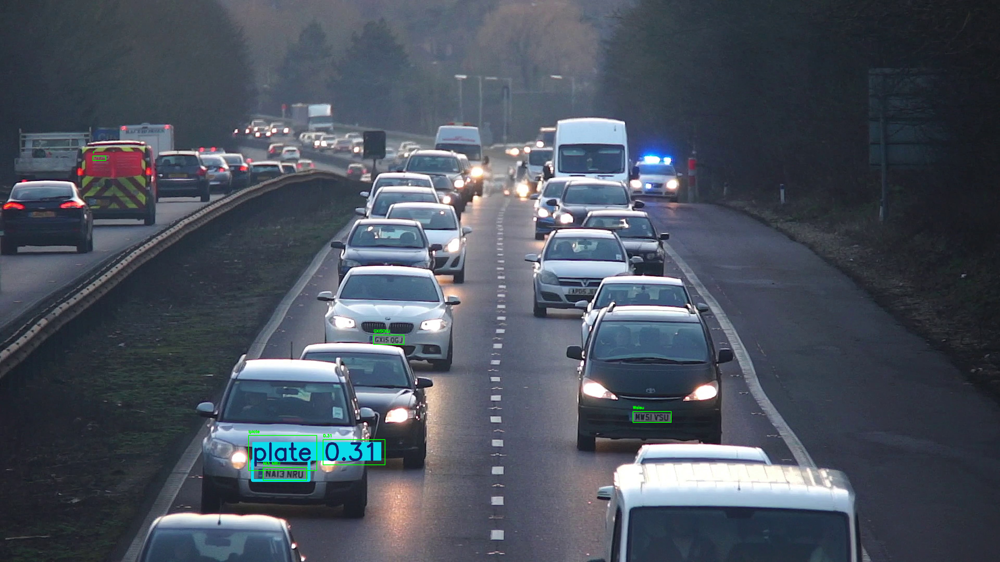

Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs

image 1/1 /content/temp_frame.jpg: 384x640 2 plates, 59.3ms
Speed: 4.3ms preprocess, 59.3ms inference, 34.8ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict10
💡 Learn more at https://docs.ultralytics.com/modes/predict


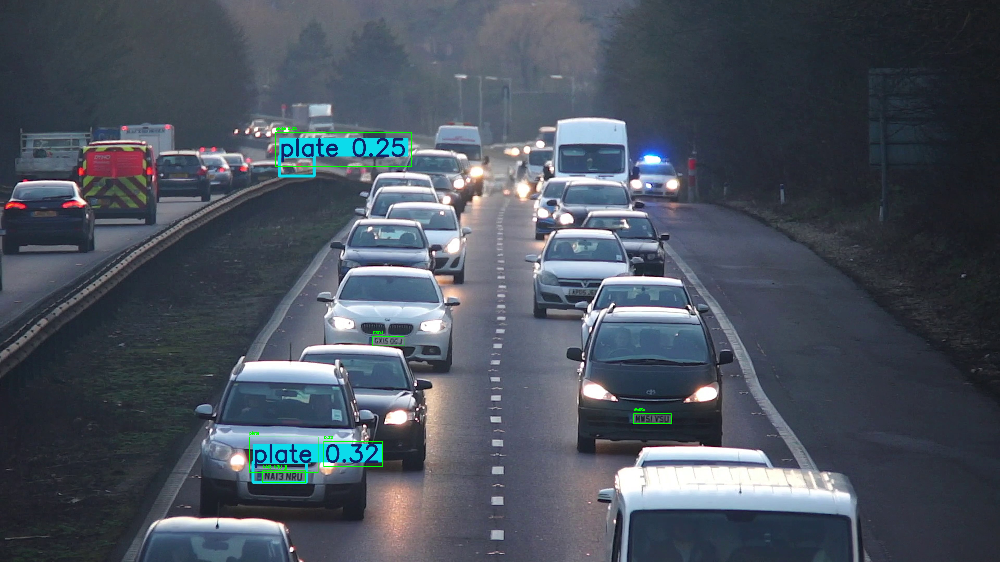

Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10b summary (fused): 383 layers, 20,414,236 parameters, 0 gradients, 97.9 GFLOPs

image 1/1 /content/temp_frame.jpg: 384x640 1 licence, 79.4ms
Speed: 4.3ms preprocess, 79.4ms inference, 54.9ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict11
💡 Learn more at https://docs.ultralytics.com/modes/predict


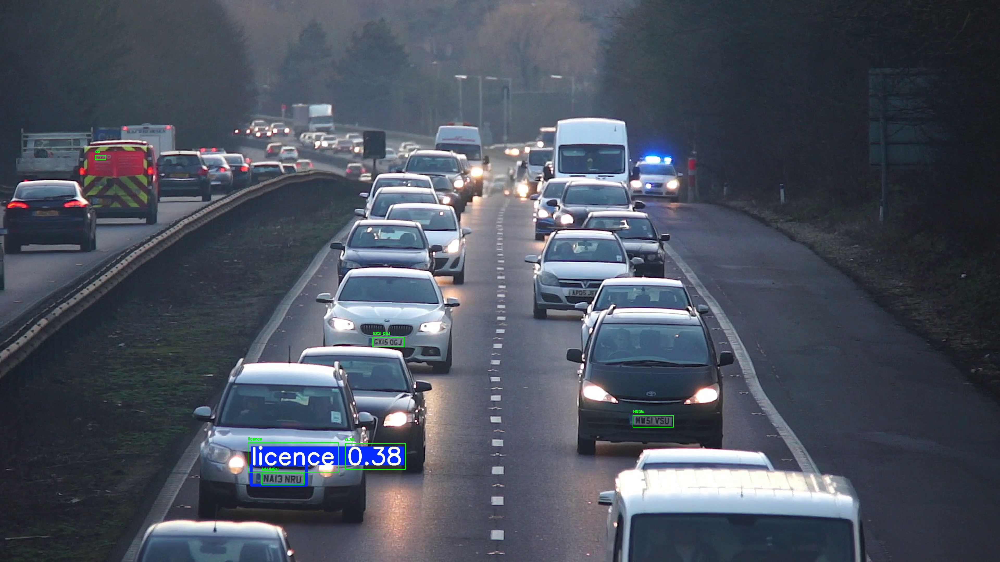

In [ ]:
import cv2
import easyocr
import os
from google.colab.patches import cv2_imshow

# Initialiser EasyOCR
reader = easyocr.Reader(['en'])

def process_video(video_path):
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print("Erreur lors de l'ouverture de la vidéo.")
        return

    prediction_count = 7
    while prediction_count < 11:  # Limiter à 4 prédictions
        ret, frame = cap.read()
        if not ret:
            break

        prediction_count += 1

        temp_image_path = 'temp_frame.jpg'
        cv2.imwrite(temp_image_path, frame)

        # Utiliser YOLO pour détecter les plaques
        !yolo task=detect mode=predict model=runs/detect/train/weights/best.pt source={temp_image_path} conf=0.25

        # Chemin de l'image annotée
        annotated_image_path = f'runs/detect/predict{prediction_count}/temp_frame.jpg'  # Ajustez le chemin
        annotated_frame = cv2.imread(annotated_image_path)

        if annotated_frame is None:
            print(f"L'image annotée pour la prédiction {prediction_count} n'a pas été trouvée.")
            continue

        results = reader.readtext(annotated_frame)

        if len(results) > 0:
            for result in results:
                text = result[1]
                box = result[0]
                x1, y1, x2, y2 = map(int, [box[0][0], box[0][1], box[2][0], box[2][1]])
                cv2.rectangle(annotated_frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(annotated_frame, text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

            # Enregistrer l'image annotée
            output_path = f'runs/detect/prediction_{prediction_count}.jpg'
            cv2.imwrite(output_path, annotated_frame)
            cv2_imshow(annotated_frame)  # Afficher l'image annotée
        else:
            print(f"Aucune plaque détectée pour la prédiction {prediction_count}.")

    cap.release()
    cv2.destroyAllWindows()

# Remplacez par le chemin de votre vidéo
video_path = '/content/video.mp4'
process_video(video_path)
